# Import Libraries

In [25]:
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt

import itertools as it

from utitilies.data_visualizers import view_clusters_3d
from algorithm.kmeans import KMeans as KMeans_2, load_ecomm_data

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load and visualize data

In [26]:
df = pd.read_csv('./data/E-commerce.csv')
df

,ID,n_clicks,n_visits,amount_spent,amount_discount,days_since_registration,profile_information
0,2085,643,142,300.000000,228.432503,132,411
1,742,527,95,743.832508,60.882831,86,184
2,750,367,49,305.668886,72.961801,334,329
3,1224,466,30,291.191193,101.903170,131,148
4,2210,715,169,703.136878,506.416735,114,160
...,...,...,...,...,...,...,...
2495,269,231,165,3328.628199,148.313702,157,314
2496,399,241,26,1985.954206,5.129457,220,206
2497,945,561,85,936.915959,146.637412,96,198
2498,771,347,61,404.905296,119.284162,194,117


In [27]:
# drop ID and profile information column column
df.drop(columns=['ID', 'profile_information'], inplace=True)
df

,n_clicks,n_visits,amount_spent,amount_discount,days_since_registration
0,643,142,300.000000,228.432503,132
1,527,95,743.832508,60.882831,86
2,367,49,305.668886,72.961801,334
3,466,30,291.191193,101.903170,131
4,715,169,703.136878,506.416735,114
...,...,...,...,...,...
2495,231,165,3328.628199,148.313702,157
2496,241,26,1985.954206,5.129457,220
2497,561,85,936.915959,146.637412,96
2498,347,61,404.905296,119.284162,194


# Preprocessing data

* ### will be later visualized in 3d so keep only 3 variables/features e.g. n_clicks, n_visits, amount_spent

##### generate permutations and then visualize

In [28]:
X = df

# find permutations of features that form clusters
permutations = list(it.permutations(df.columns, 3))
permutations

[('n_clicks', 'n_visits', 'amount_spent'),
 ('n_clicks', 'n_visits', 'amount_discount'),
 ('n_clicks', 'n_visits', 'days_since_registration'),
 ('n_clicks', 'amount_spent', 'n_visits'),
 ('n_clicks', 'amount_spent', 'amount_discount'),
 ('n_clicks', 'amount_spent', 'days_since_registration'),
 ('n_clicks', 'amount_discount', 'n_visits'),
 ('n_clicks', 'amount_discount', 'amount_spent'),
 ('n_clicks', 'amount_discount', 'days_since_registration'),
 ('n_clicks', 'days_since_registration', 'n_visits'),
 ('n_clicks', 'days_since_registration', 'amount_spent'),
 ('n_clicks', 'days_since_registration', 'amount_discount'),
 ('n_visits', 'n_clicks', 'amount_spent'),
 ('n_visits', 'n_clicks', 'amount_discount'),
 ('n_visits', 'n_clicks', 'days_since_registration'),
 ('n_visits', 'amount_spent', 'n_clicks'),
 ('n_visits', 'amount_spent', 'amount_discount'),
 ('n_visits', 'amount_spent', 'days_since_registration'),
 ('n_visits', 'amount_discount', 'n_clicks'),
 ('n_visits', 'amount_discount', 'am

# Exploratory data analysis

In [29]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2500 entries, 0 to 2499
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   n_clicks                 2500 non-null   int64  
 1   n_visits                 2500 non-null   int64  
 2   amount_spent             2500 non-null   float64
 3   amount_discount          2500 non-null   float64
 4   days_since_registration  2500 non-null   int64  
dtypes: float64(2), int64(3)
memory usage: 97.8 KB


## Checking for null values

In [30]:
X.isnull().sum()

n_clicks                   0
n_visits                   0
amount_spent               0
amount_discount            0
days_since_registration    0
dtype: int64

## Checking the standard deviation, mean, quartiles etc. of each feature column

In [31]:
X.describe()

,n_clicks,n_visits,amount_spent,amount_discount,days_since_registration
count,2500.00000,2500.000000,2500.000000,2500.000000,2500.000000
mean,408.68000,94.475600,1445.090745,388.508637,200.973600
std,186.41409,38.866356,1167.663473,487.143968,99.136618
min,50.00000,10.000000,0.000000,0.000000,0.000000
25%,274.75000,67.000000,609.618538,56.298615,130.000000
50%,378.00000,92.000000,1036.189112,137.454623,200.000000
75%,522.00000,119.000000,1949.270949,679.540536,268.000000
max,1246.00000,259.000000,6567.402267,2428.406527,514.000000


## seeing if there are any feature columns that are correlated with one another

In [32]:
corr_matrix = df.corr()
corr_matrix.style.background_gradient(cmap='magma')

,n_clicks,n_visits,amount_spent,amount_discount,days_since_registration
n_clicks,1.000000,0.340079,-0.288438,0.519225,-0.012087
n_visits,0.340079,1.000000,-0.217225,0.439417,0.032341
amount_spent,-0.288438,-0.217225,1.000000,0.018152,-0.005042
amount_discount,0.519225,0.439417,0.018152,1.000000,0.011790
days_since_registration,-0.012087,0.032341,-0.005042,0.011790,1.000000


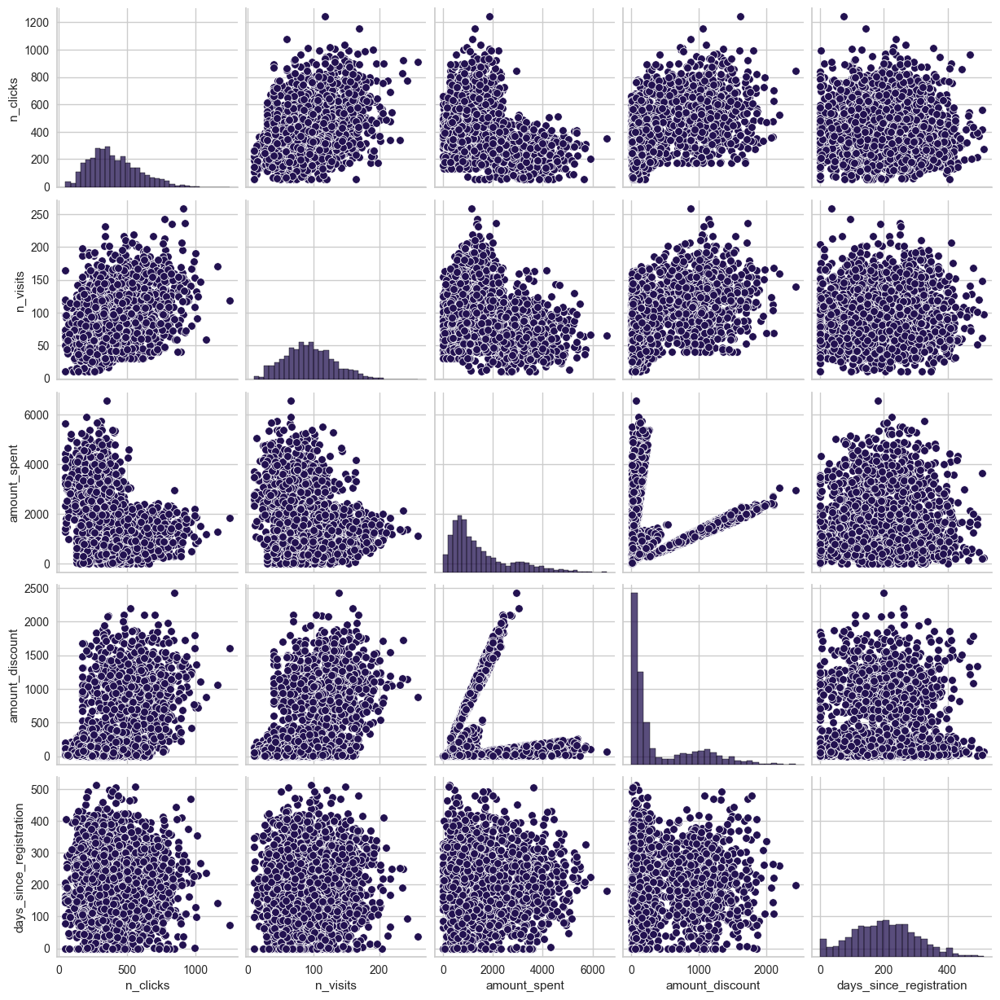

In [33]:
sb.set_palette('magma')
sb.pairplot(X)
plt.show()

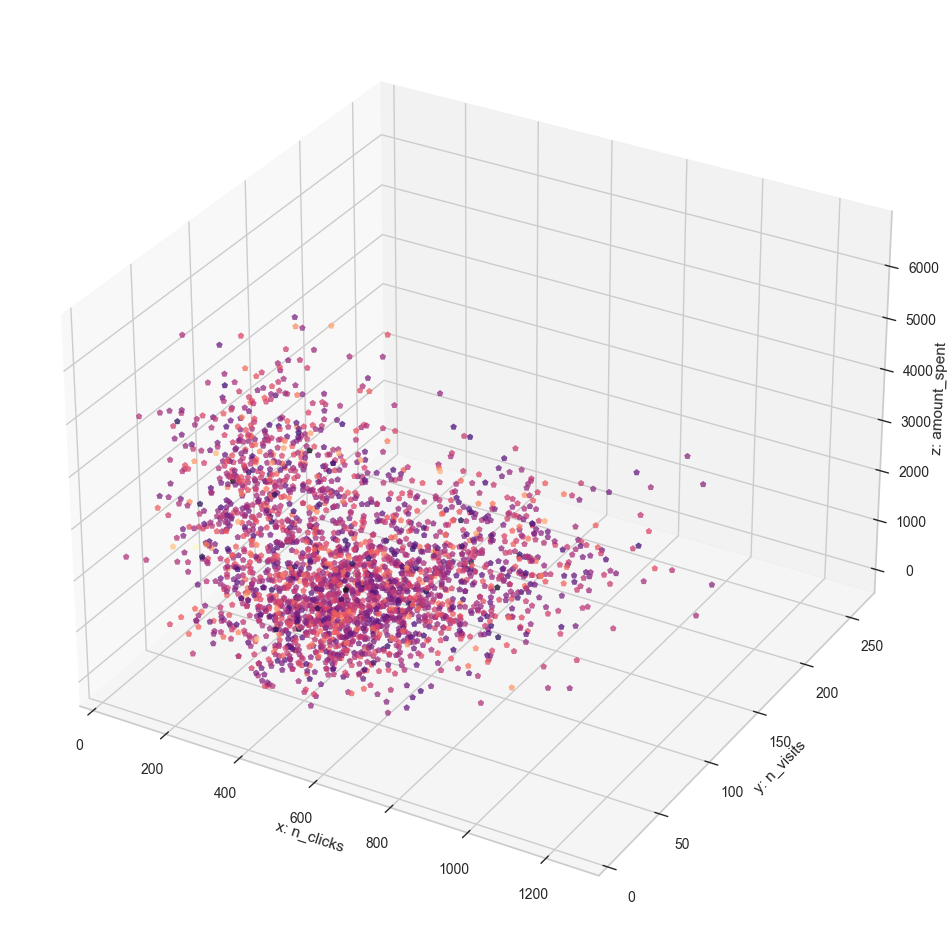

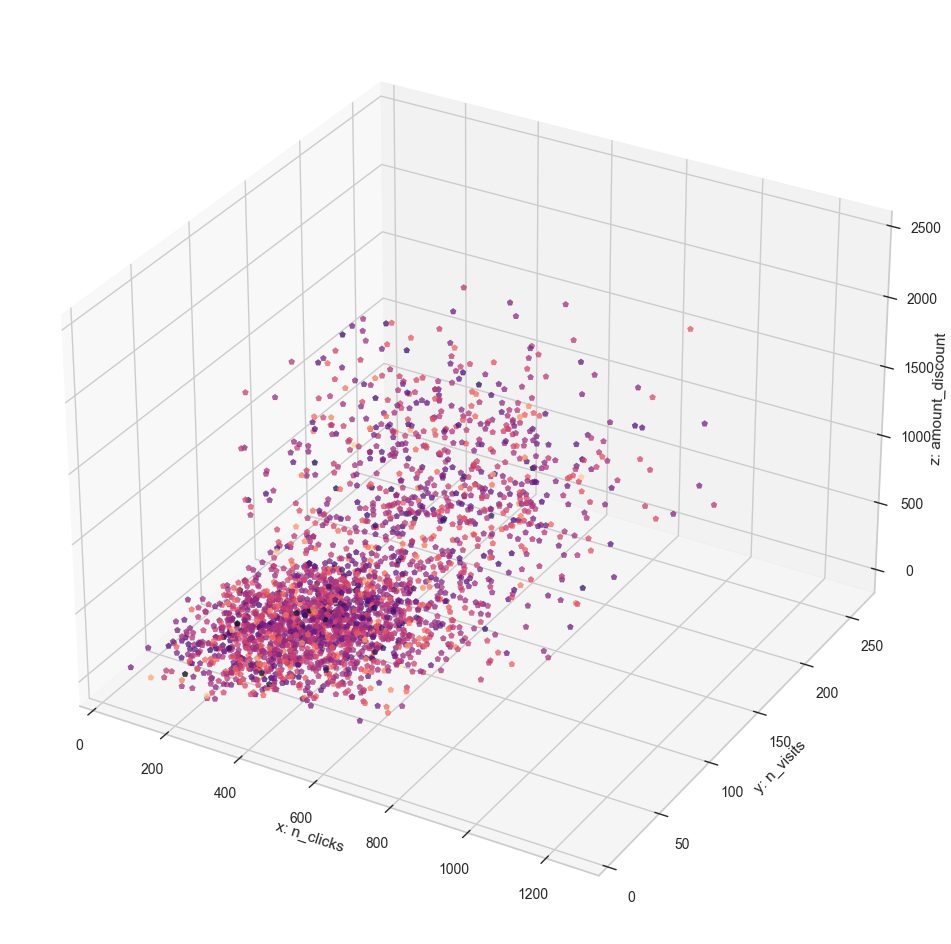

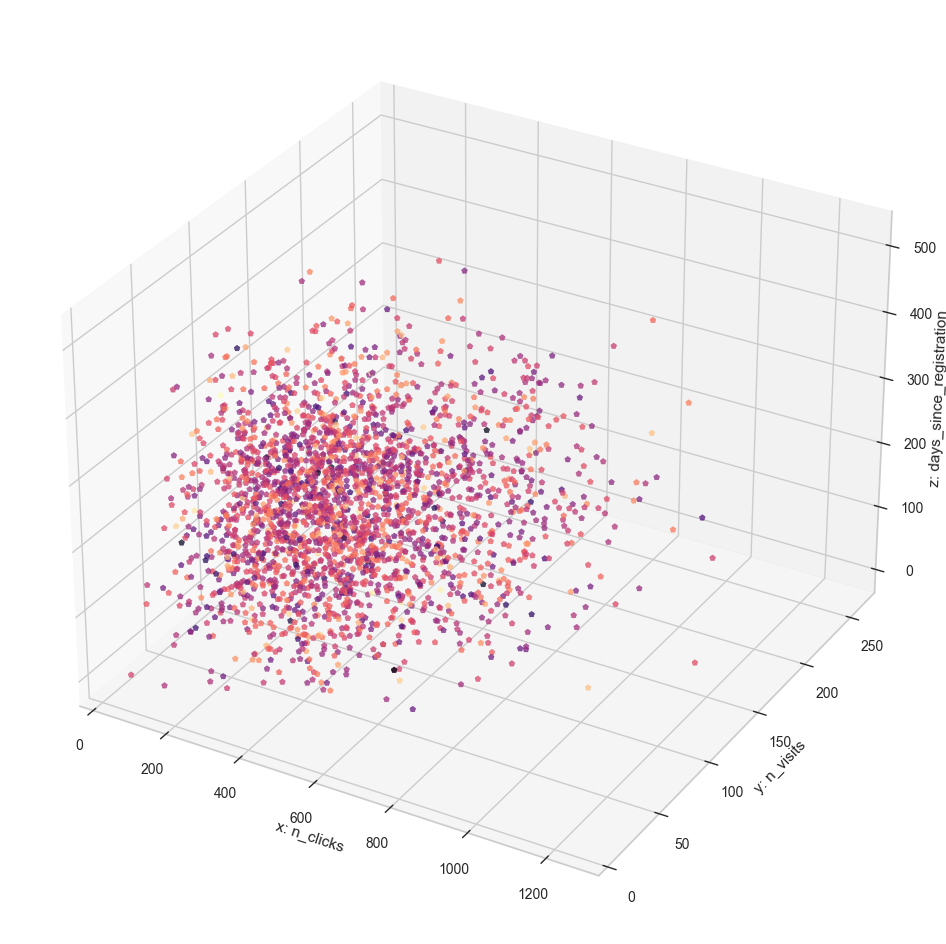

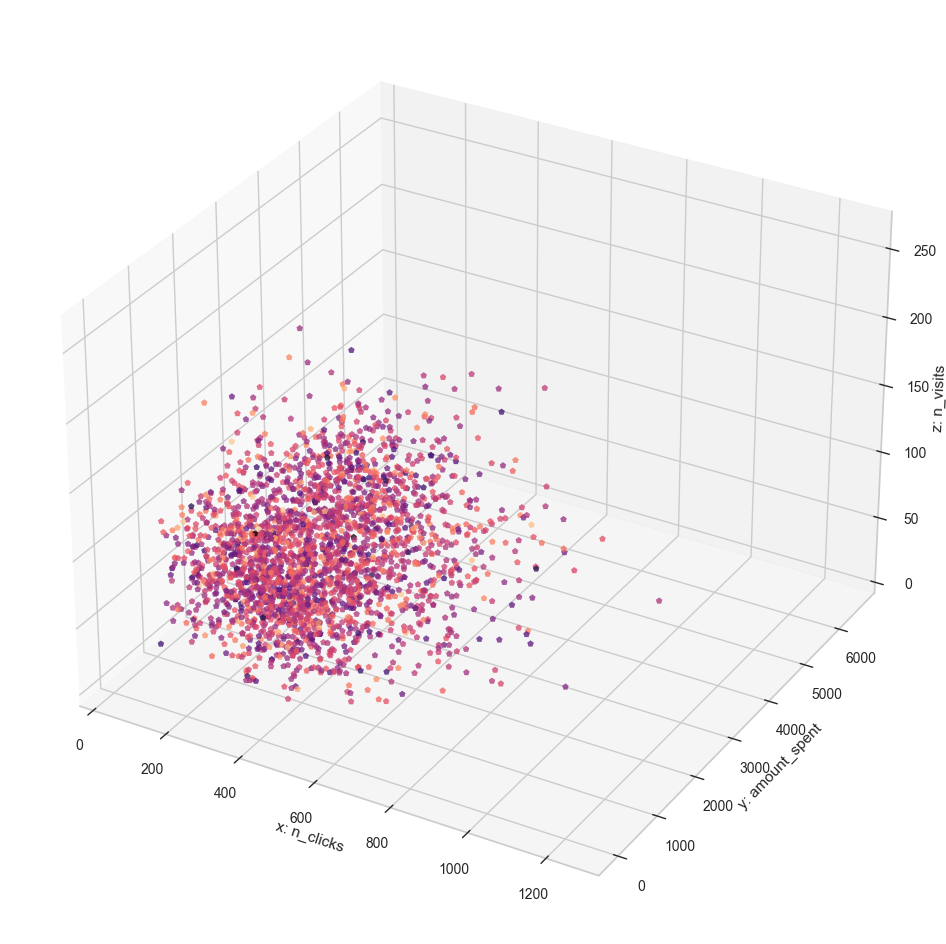

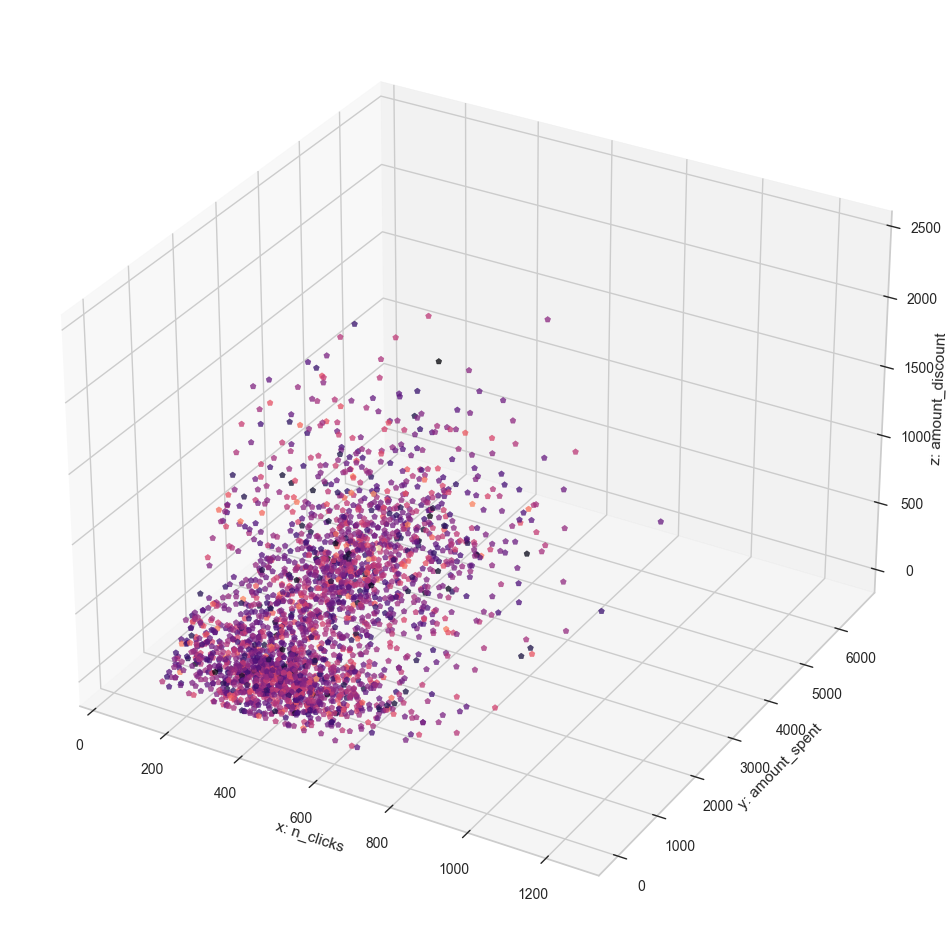

...

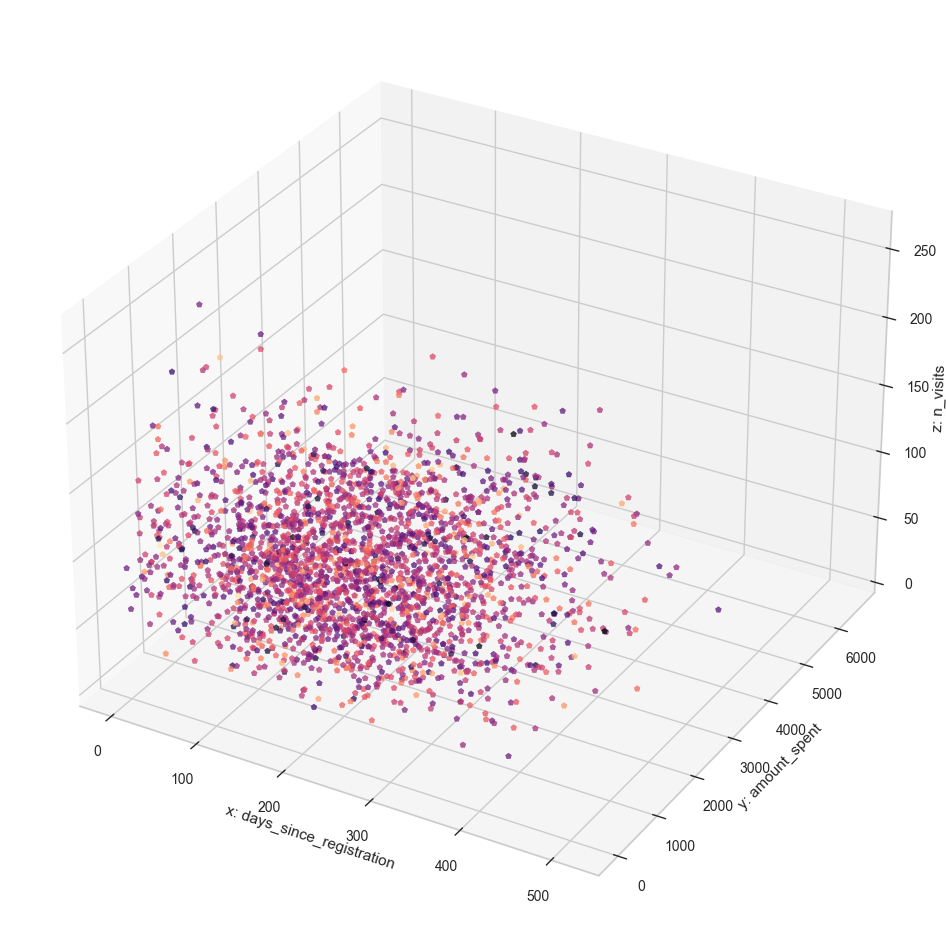

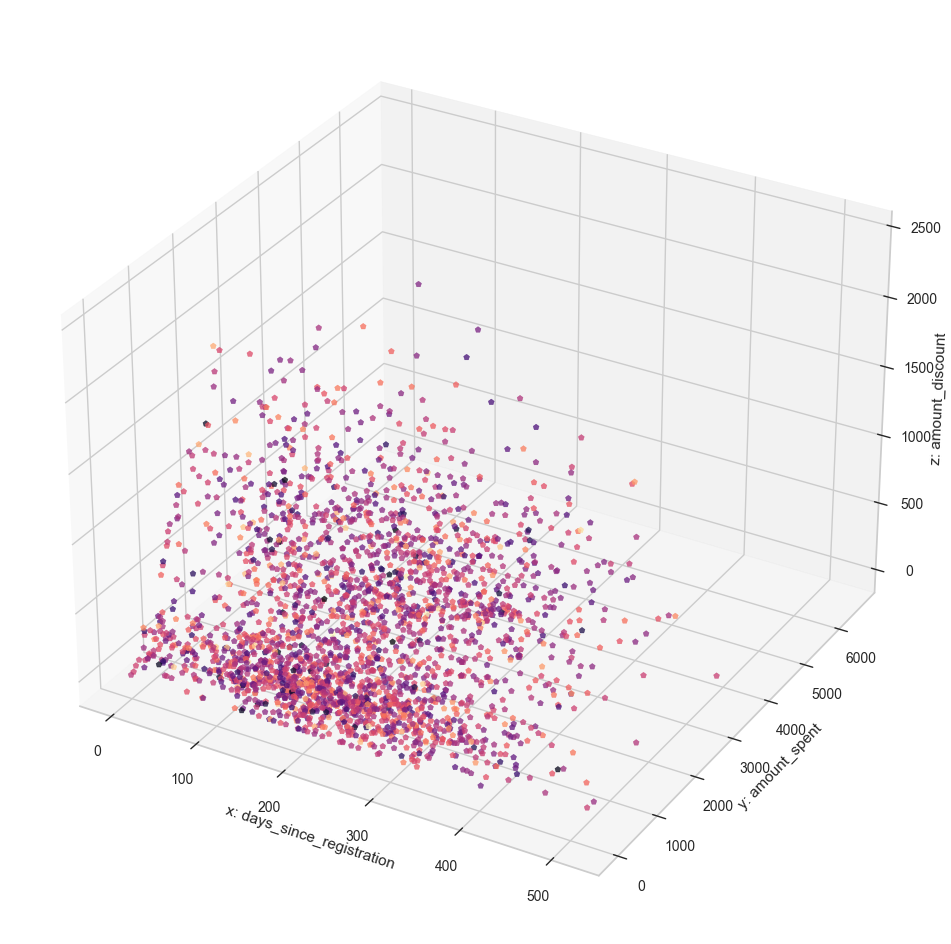

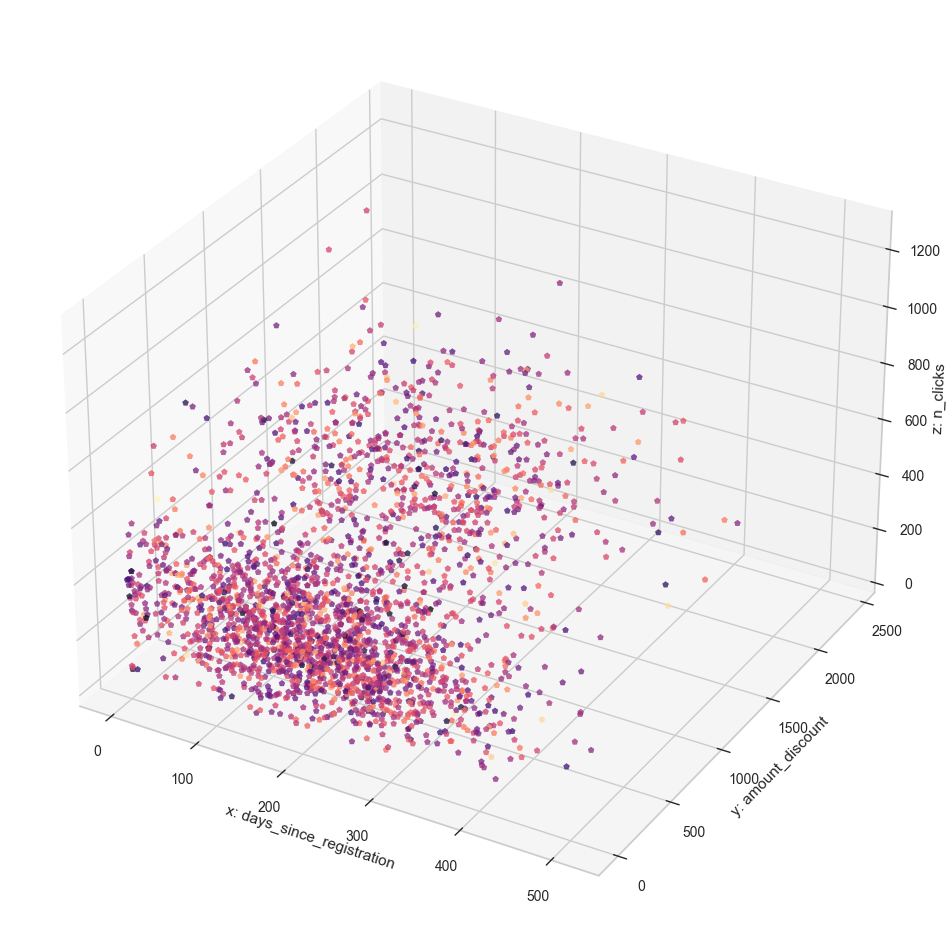

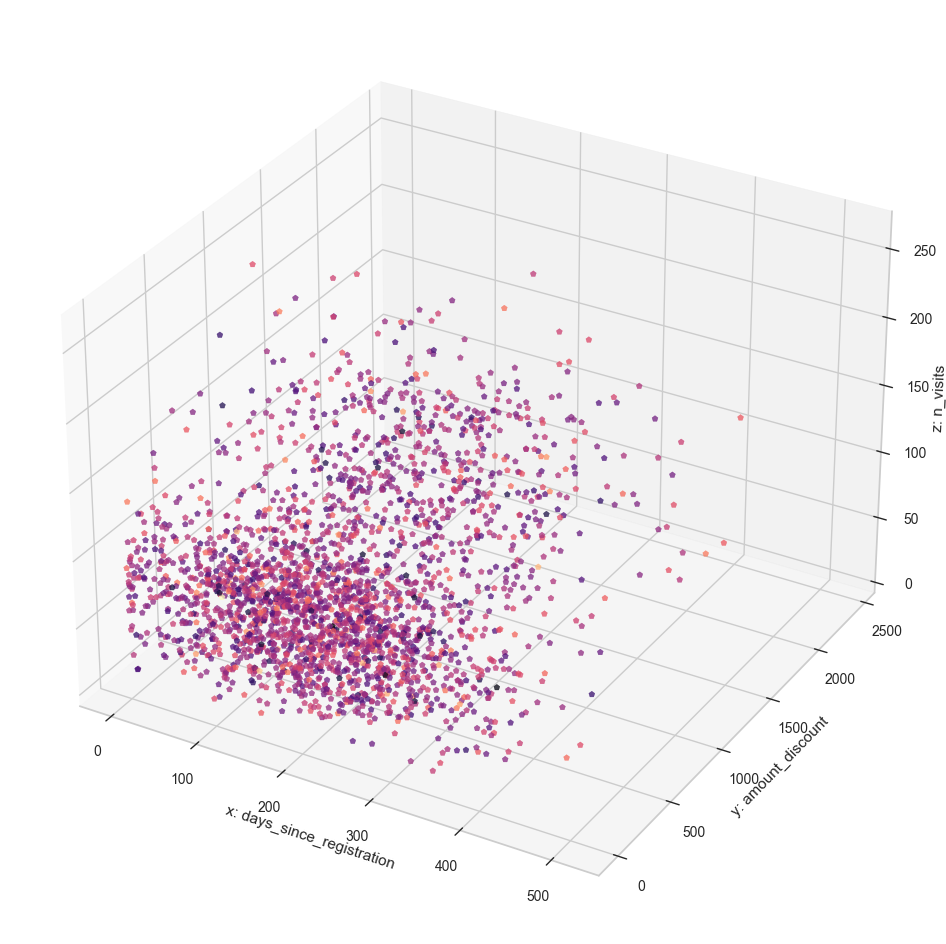

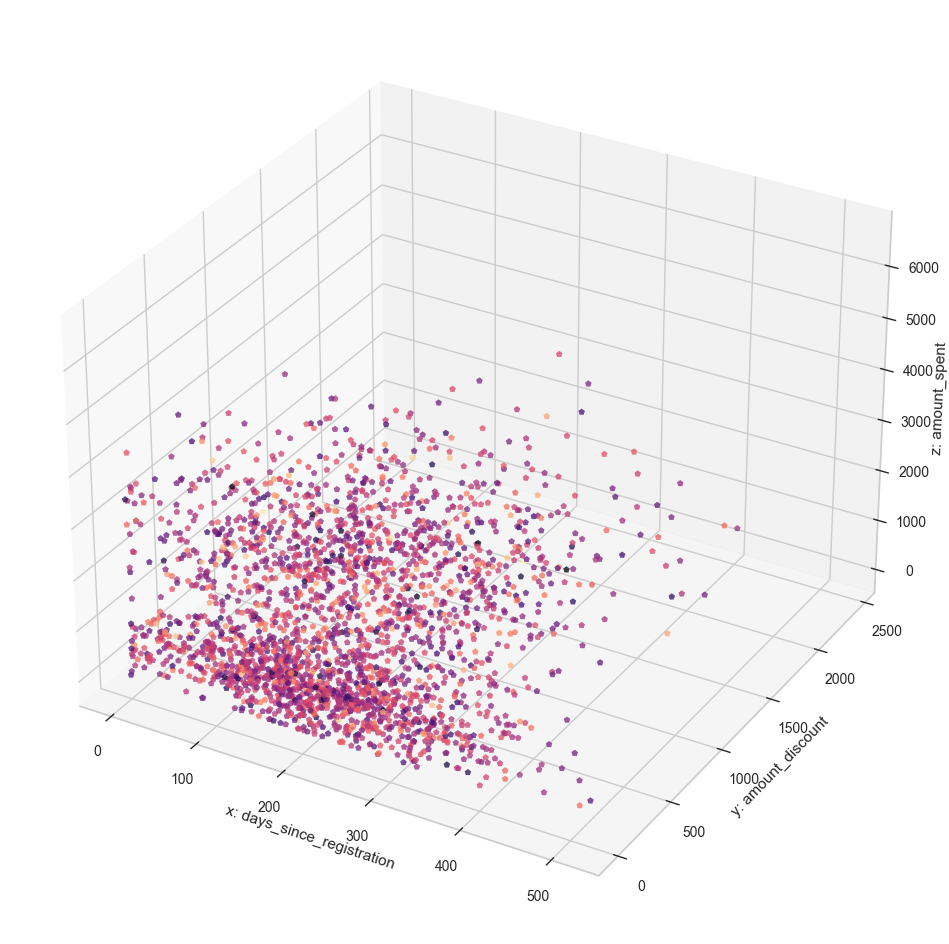

In [34]:
for permutation in permutations:
    view_clusters_3d(X, list(permutation))

#### handpicked features with more than 1 cluster
- n_clicks, n_visits, amount_discount 2
- n_clicks, amount_spent, amount_discount 2.5
- n_clicks, amount_discount, n_visits 2
- n_clicks, amount_discount, amount_spent 3 
- n_clicks, amount_discount, days_since_registration 2

- n_visits, n_clicks, amount_discount 2
- n_visits, amount_spent, amount_discount 1.5
- n_visits, amount_discount, n_clicks 2
- n_visits, amount_discount, amount_spent 3

- amount_spent, n_clicks, n_visits 1.5
- amount_spent, n_clicks, amount_discount 3
- amount_spent, n_visits, n_clicks 2
- amount_spent, n_visits, amount_discount 3
- amount_spent, amount_discount, n_clicks 3
- amount_spent, amount_discount, n_vists 3
- amount_spent, days_since_registration, n_clicks 2 
- amount_spent, days_since_registration, n_visits 2 
- amount_spent, days_since_registration, amount_discount 3

- amount_discount, n_clicks, n_visits 2
- amount discount, n_clicks, amount_spent 3
- amount discount, n_clicks, days_since_registration 2
- amount_discount, n_visits, n_clicks 2
- amount_discount, n_visits, amount_spent 3
- amount_discount, n_visits, days_since_registration 2
- amount_discount, days_since_registration, amount_spent 3

**next is to pick the the feature sets with the most relevant feawtures and with clusters more than or equal 2**

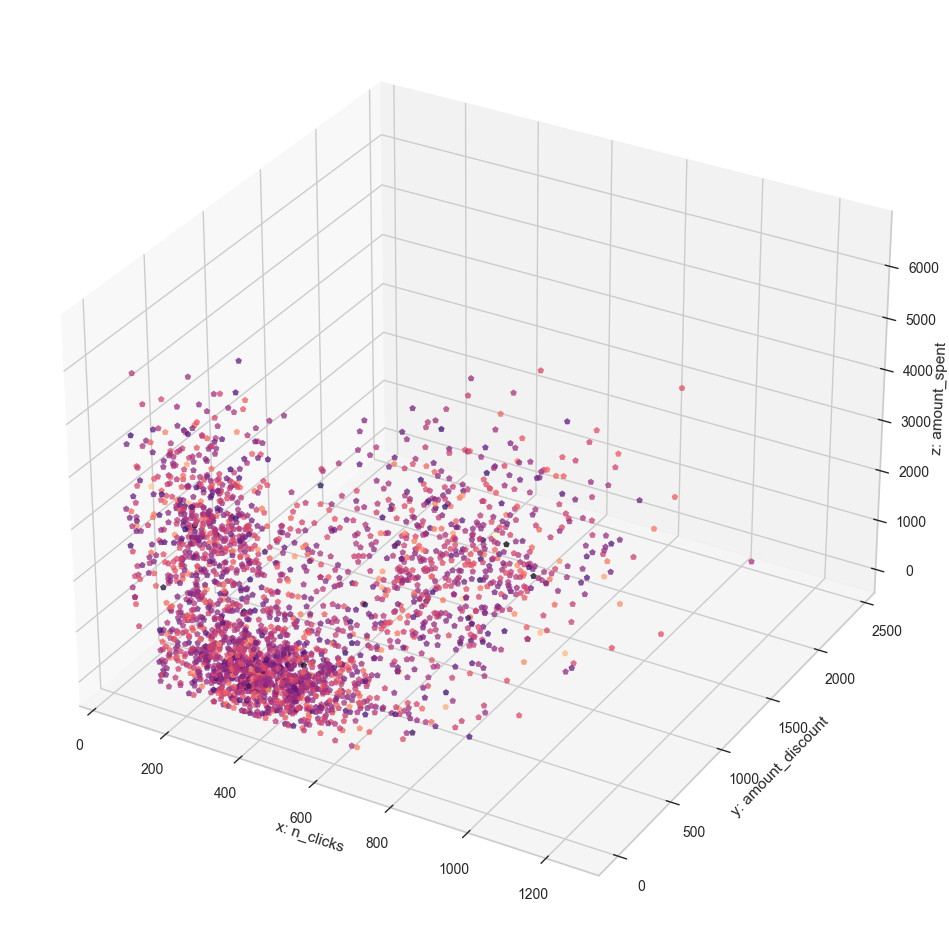

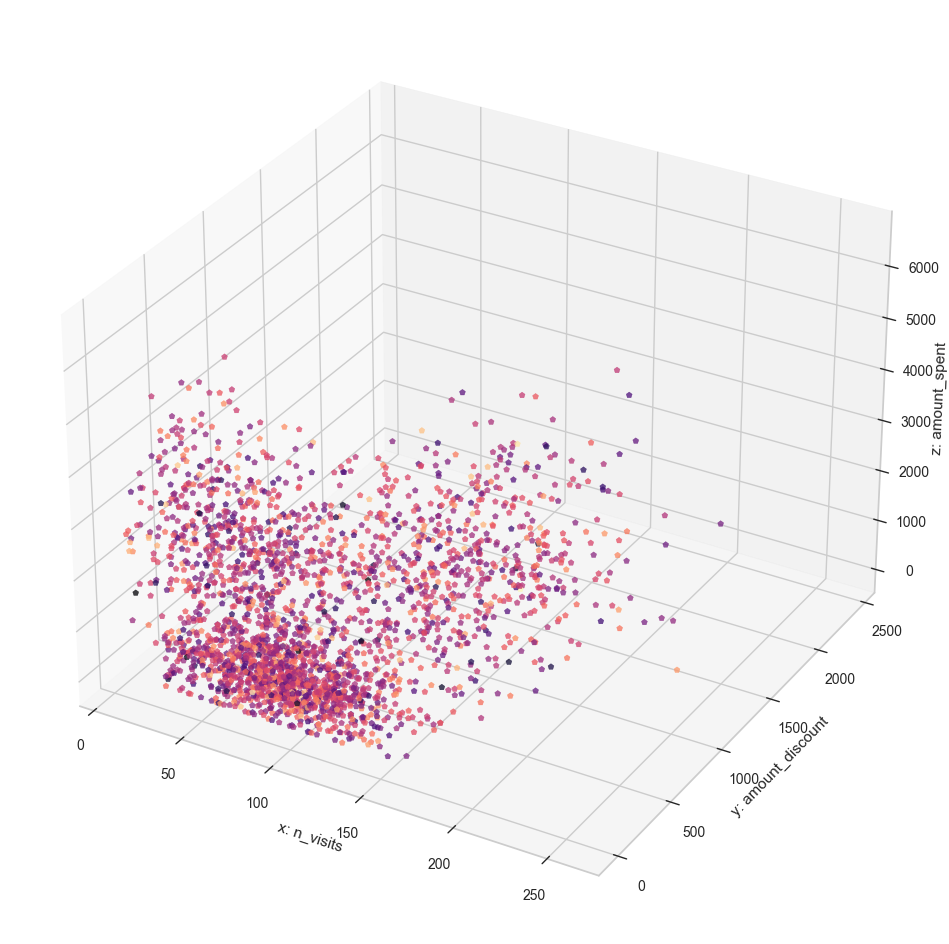

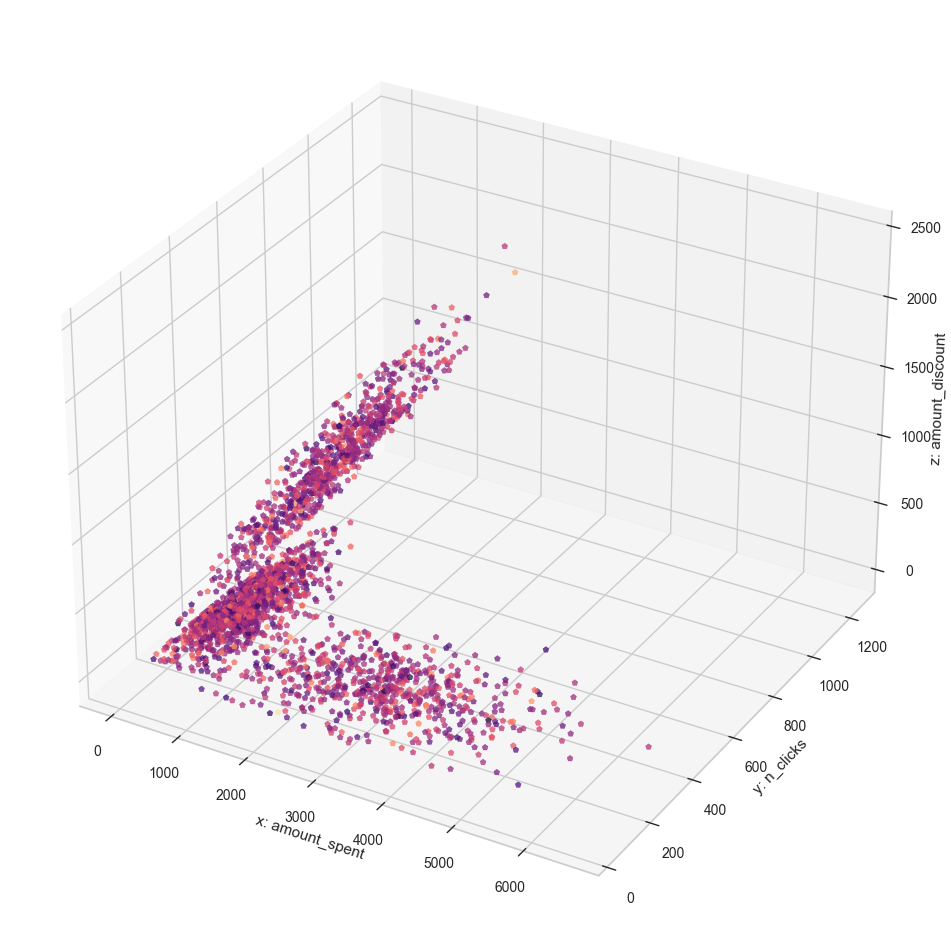

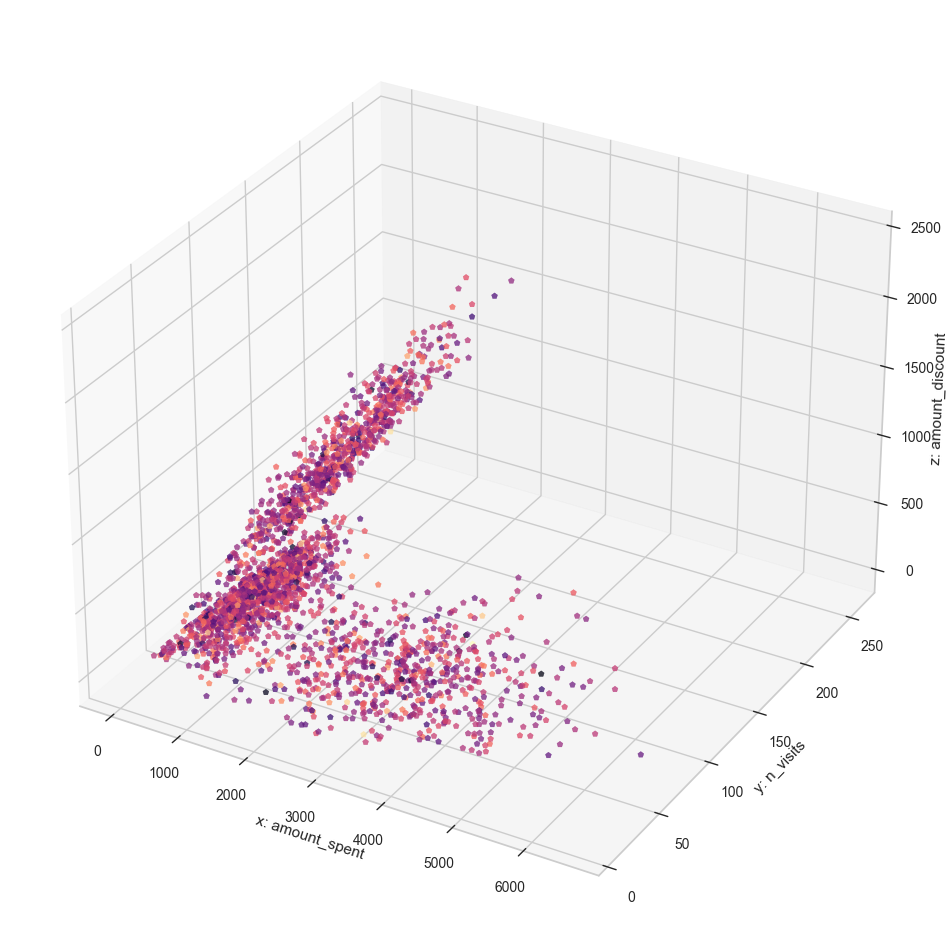

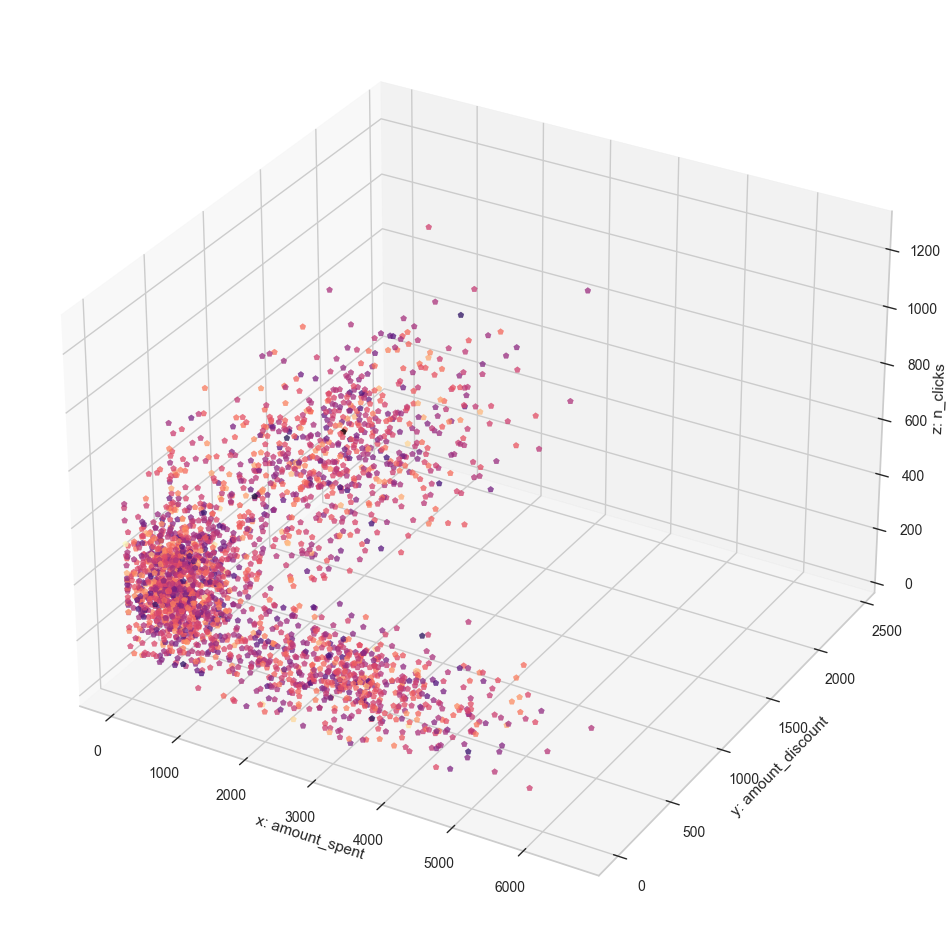

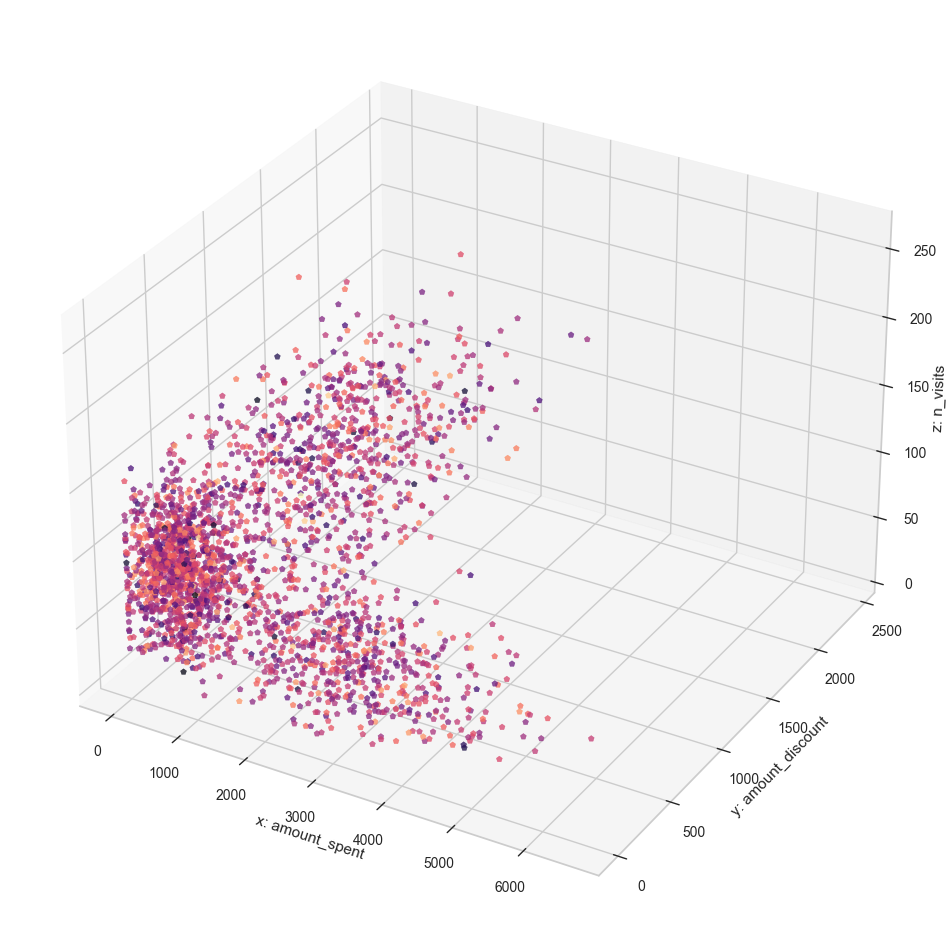

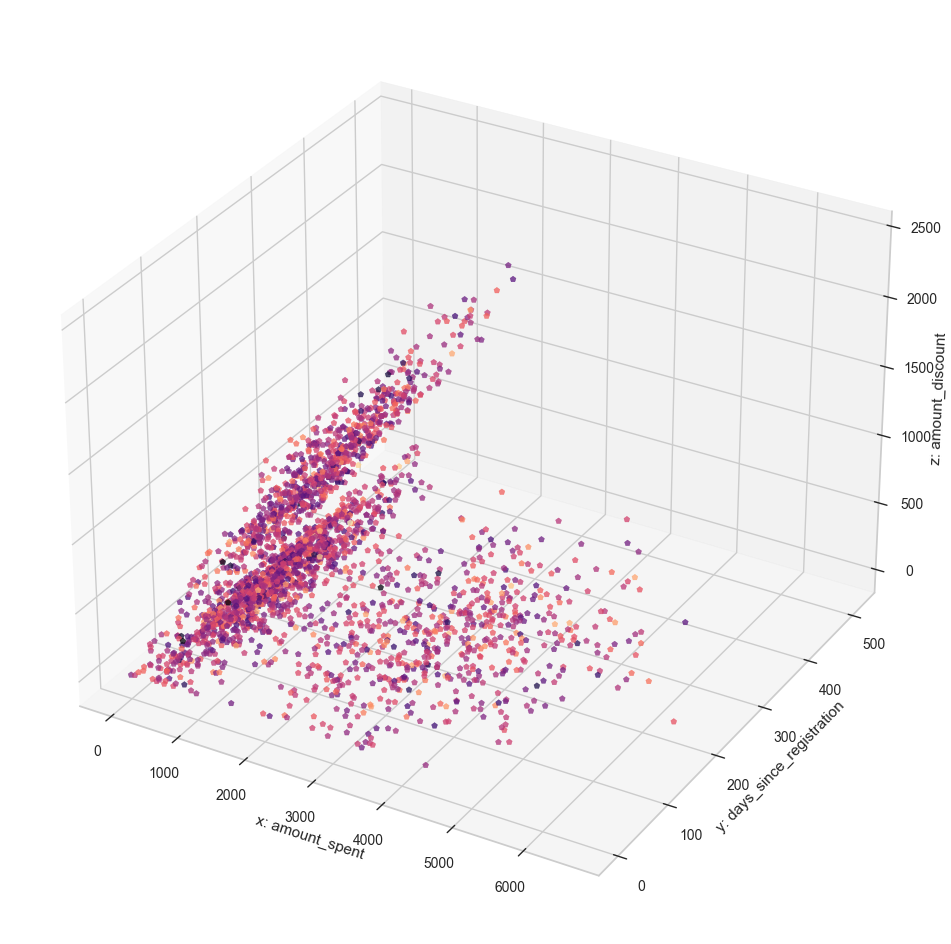

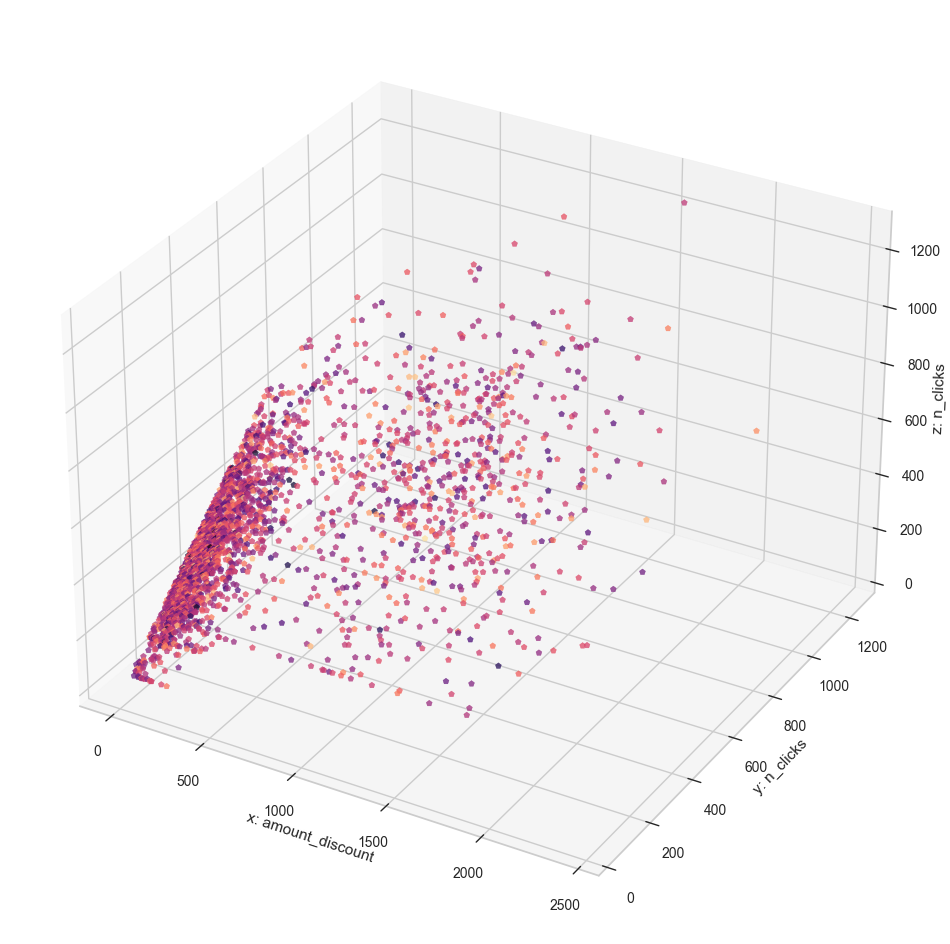

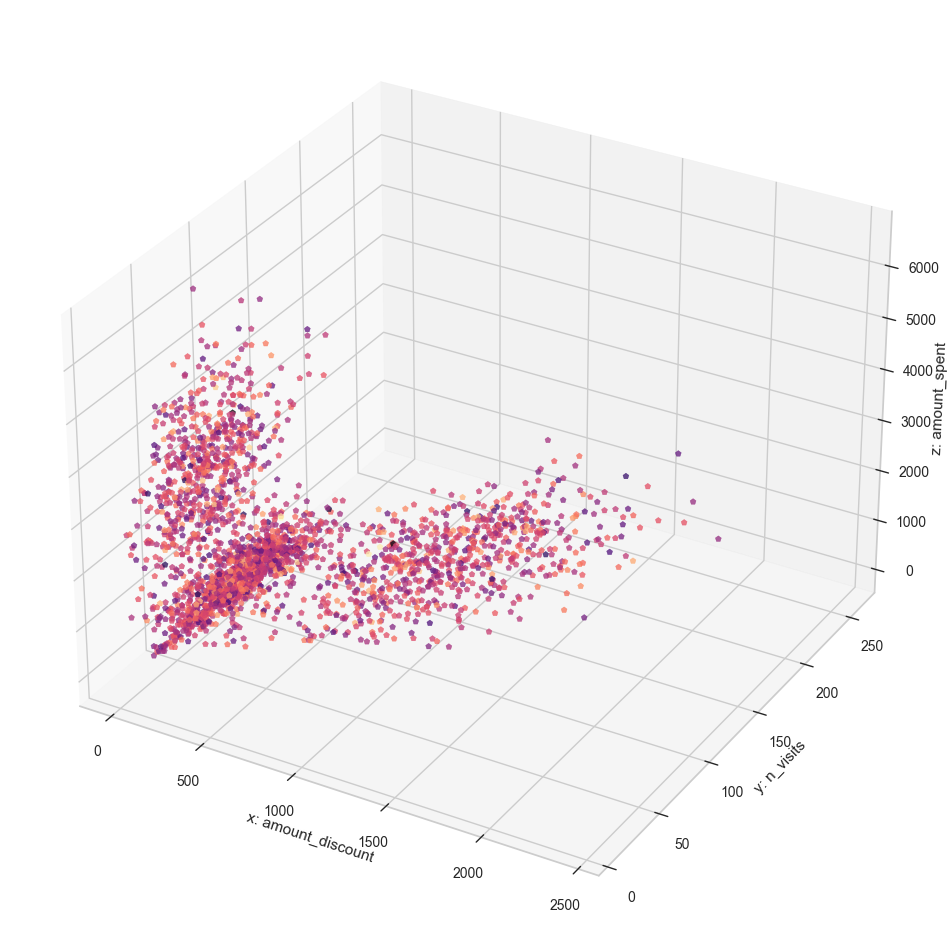

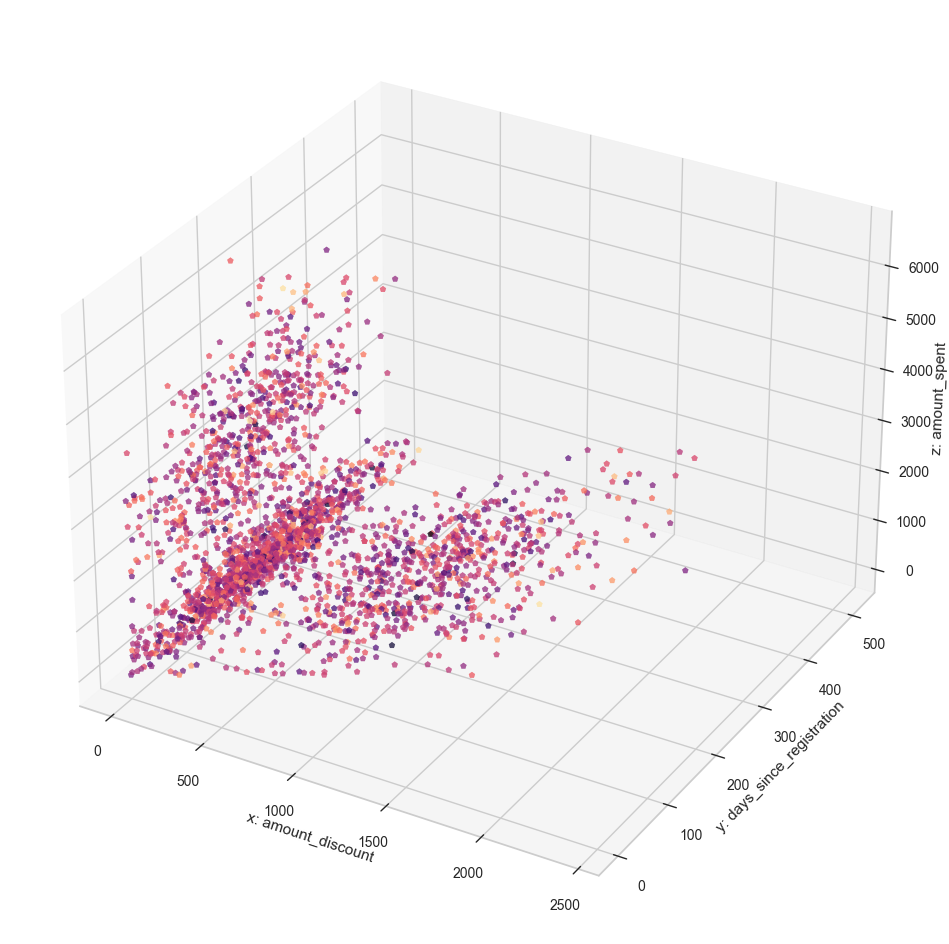

In [35]:
# re visualize datapoints with 3 or more clusters

feature_sets = [
    ['n_clicks', 'amount_discount', 'amount_spent'],
    ['n_visits', 'amount_discount', 'amount_spent'],
    ['amount_spent', 'n_clicks', 'amount_discount'],
    ['amount_spent', 'n_visits', 'amount_discount'],
    ['amount_spent', 'amount_discount', 'n_clicks'],
    ['amount_spent', 'amount_discount', 'n_visits'],
    ['amount_spent', 'days_since_registration', 'amount_discount'],
    ['amount_discount', 'n_clicks', 'n_clicks'],
    ['amount_discount', 'n_visits', 'amount_spent'],
    ['amount_discount', 'days_since_registration', 'amount_spent']
]

for feature_set in feature_sets:
    view_clusters_3d(X, feature_set)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[[ 643.          228.43250321  300.        ]
 [ 527.           60.88283134  743.83250752]
 [ 367.           72.96180132  305.66888582]
 ...
 [ 561.          146.63741213  936.91595926]
 [ 347.          119.28416225  404.90529604]
 [ 823.         1138.21948445 1433.67721871]]
initial centroids [[ 269.           85.288592    508.95367215]
 [ 552.          650.55391932  912.15032522]
 [ 191.          109.29504181 3786.0707697 ]]



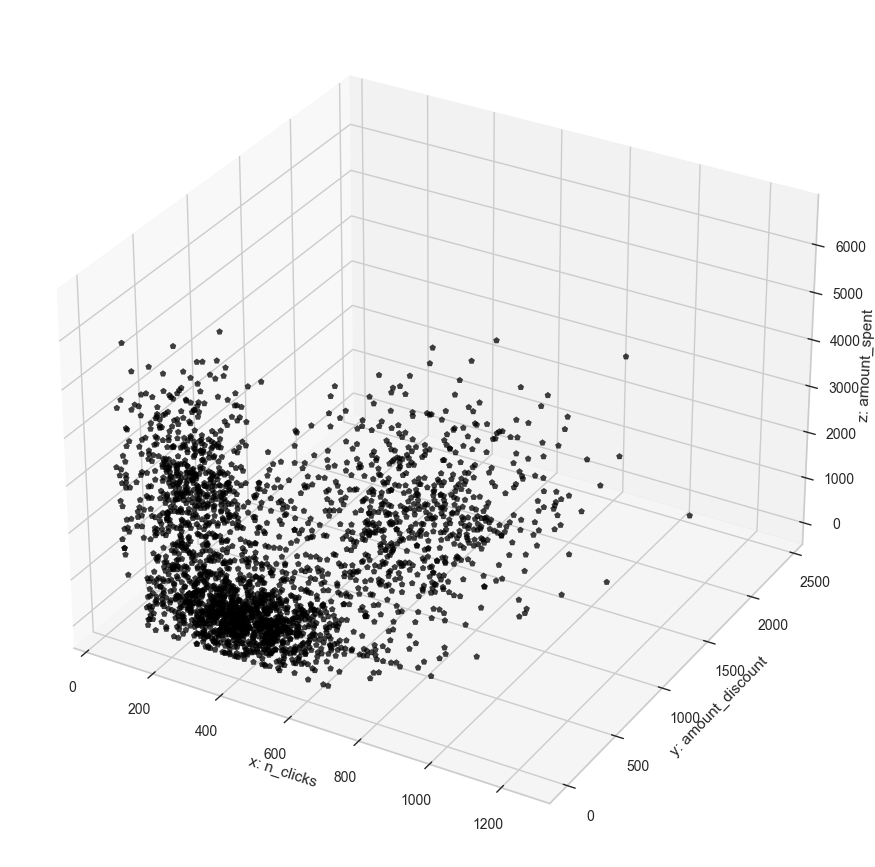

centroid at epoch 0/299: 
[[ 269.           85.288592    508.95367215]
 [ 552.          650.55391932  912.15032522]
 [ 191.          109.29504181 3786.0707697 ]]

points of cluster 0: [[643.         228.43250321 300.        ]
 [527.          60.88283134 743.83250752]
 [367.          72.96180132 305.66888582]
 ...
 [628.         143.9583226  405.20688739]
 [414.         206.5650959  638.1128076 ]
 [347.         119.28416225 404.90529604]]

points of cluster 1: [[ 715.          506.41673523  703.13687786]
 [ 600.          717.69649646 1008.16977135]
 [ 321.          262.88586839  976.53162497]
 ...
 [ 241.            5.12945728 1985.95420556]
 [ 561.          146.63741213  936.91595926]
 [ 823.         1138.21948445 1433.67721871]]

points of cluster 2: [[ 339.           43.9636836  3550.73229352]
 [ 169.          145.46900631 4006.94232947]
 [ 337.           57.45648623 2335.62131143]
 ...
 [ 142.           59.69034898 3480.21578457]
 [ 178.           81.04646503 3341.99832216]
 [ 231. 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


centroid at epoch 299/299: 
[[ 405.1301059   172.15421435  633.36891206]
 [ 527.27565982 1029.18705029 1561.2118481 ]
 [ 255.07258065   84.2301466  3448.92476087]]

m: (301, 3)
centroids of cluster 0: [[269.          85.288592   508.95367215]
 [383.40830116 109.36592173 542.1040397 ]
 [399.42797669 143.96704403 586.76932647]
 [401.20094192 158.85460854 615.87556875]
 [404.36495792 167.80113961 627.75622266]
 [404.8168693  170.55419281 630.9692835 ]
 [405.21212121 171.82908342 632.35100663]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 [405.1301059  172.15421435 633.36891206]
 

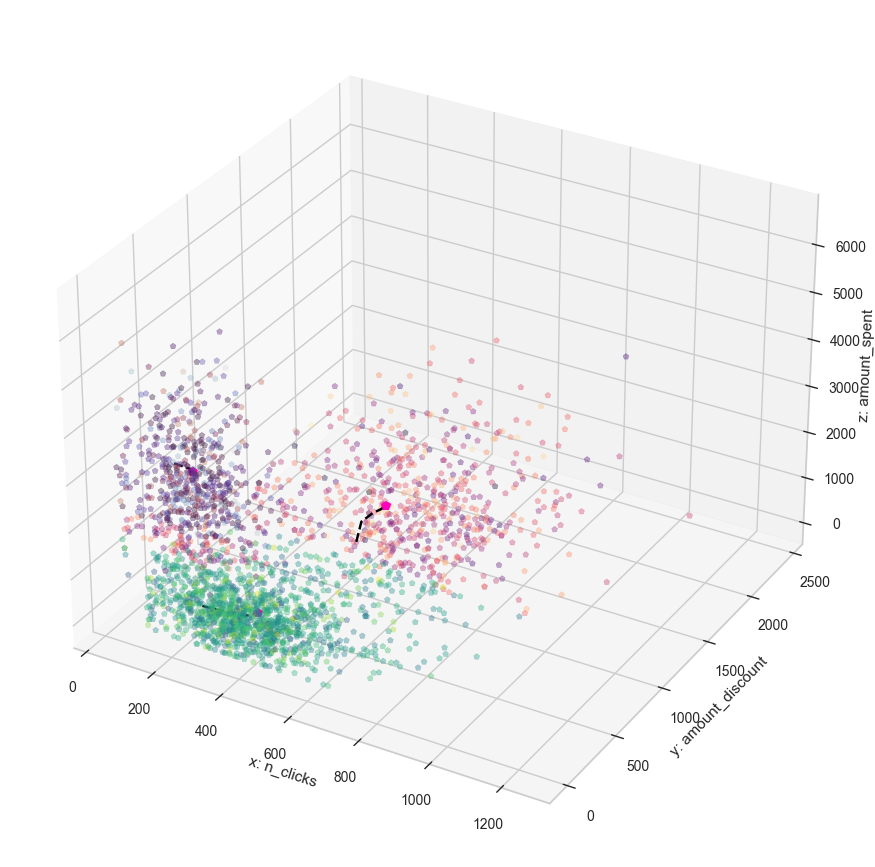

In [36]:
data = load_ecomm_data('./data/E-commerce.csv', ['n_clicks', 'amount_discount', 'amount_spent'])

# model = KMeans(data, 3,)
model = KMeans_2(data, 3, epochs=300, dist_metric='minkowski', features=['n_clicks', 'amount_discount', 'amount_spent'], p=2)
model.train()

here we have 3 clusters of users of the e-commerce platform consisting of
users clicking/interacting with the app ranging from 0 to 800, amount discounts  ranging from 0 to more than 1000, and amount spent ranging from 


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[[ 142.          228.43250321  300.        ]
 [  95.           60.88283134  743.83250752]
 [  49.           72.96180132  305.66888582]
 ...
 [  85.          146.63741213  936.91595926]
 [  61.          119.28416225  404.90529604]
 [ 160.         1138.21948445 1433.67721871]]
initial centroids [[ 144.           19.9482271   815.59578848]
 [  99.           45.09240137  451.11674007]
 [  78.           90.36130698 4681.31526905]]



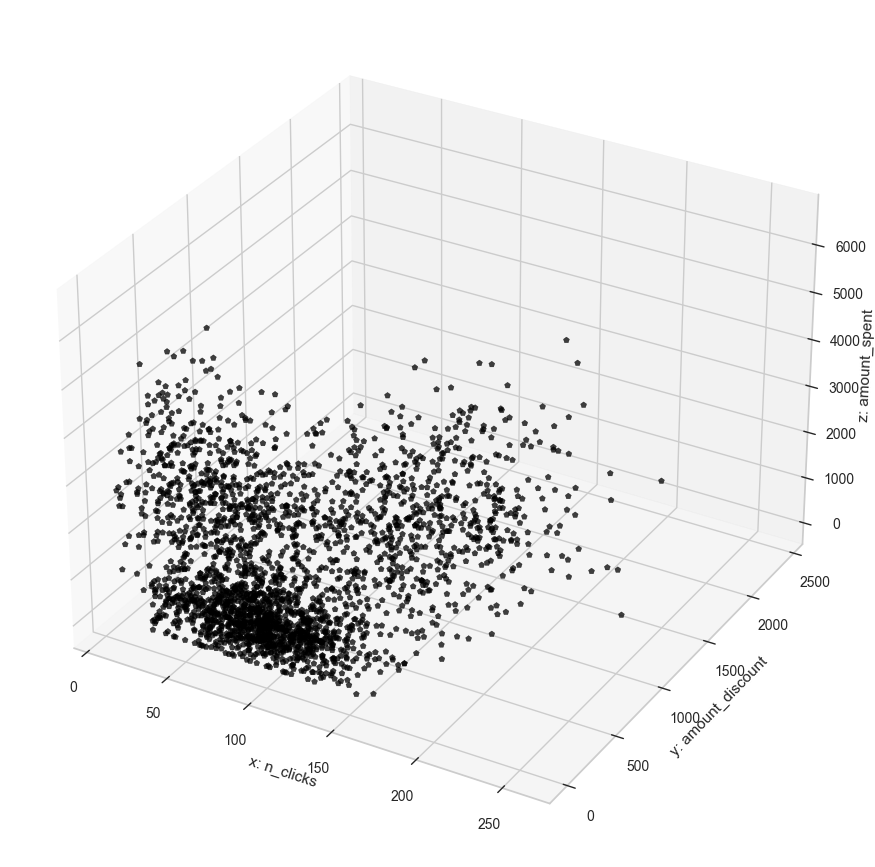

centroid at epoch 0/299: 
[[ 144.           19.9482271   815.59578848]
 [  99.           45.09240137  451.11674007]
 [  78.           90.36130698 4681.31526905]]

points of cluster 0: [[  95.           60.88283134  743.83250752]
 [ 169.          506.41673523  703.13687786]
 [ 135.          717.69649646 1008.16977135]
 ...
 [  26.            5.12945728 1985.95420556]
 [  85.          146.63741213  936.91595926]
 [ 160.         1138.21948445 1433.67721871]]

points of cluster 1: [[142.         228.43250321 300.        ]
 [ 49.          72.96180132 305.66888582]
 [ 30.         101.90316953 291.191193  ]
 ...
 [107.         143.9583226  405.20688739]
 [ 42.         206.5650959  638.1128076 ]
 [ 61.         119.28416225 404.90529604]]

points of cluster 2: [[  87.           43.9636836  3550.73229352]
 [  54.          145.46900631 4006.94232947]
 [  32.          133.83974984 4795.65243432]
 ...
 [  10.           59.69034898 3480.21578457]
 [  63.           81.04646503 3341.99832216]
 [ 165. 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


centroid at epoch 298/299: 
[[ 114.59708029 1020.9270219  1568.21211097]
 [  93.45990923  174.23723234  631.30338395]
 [  69.24137931   84.37111811 3456.22412563]]

points of cluster 0: [[ 135.          717.69649646 1008.16977135]
 [ 114.          790.61843479 1069.99896794]
 [ 119.         1320.84559926 1732.18267319]
 ...
 [ 146.         1855.35659043 2217.9562001 ]
 [  26.            5.12945728 1985.95420556]
 [ 160.         1138.21948445 1433.67721871]]

points of cluster 1: [[142.         228.43250321 300.        ]
 [ 95.          60.88283134 743.83250752]
 [ 49.          72.96180132 305.66888582]
 ...
 [ 99.         693.29050793 914.89154263]
 [ 85.         146.63741213 936.91595926]
 [ 61.         119.28416225 404.90529604]]

points of cluster 2: [[  87.           43.9636836  3550.73229352]
 [  54.          145.46900631 4006.94232947]
 [ 114.           57.45648623 2335.62131143]
 ...
 [  10.           59.69034898 3480.21578457]
 [  63.           81.04646503 3341.99832216]
 [ 165

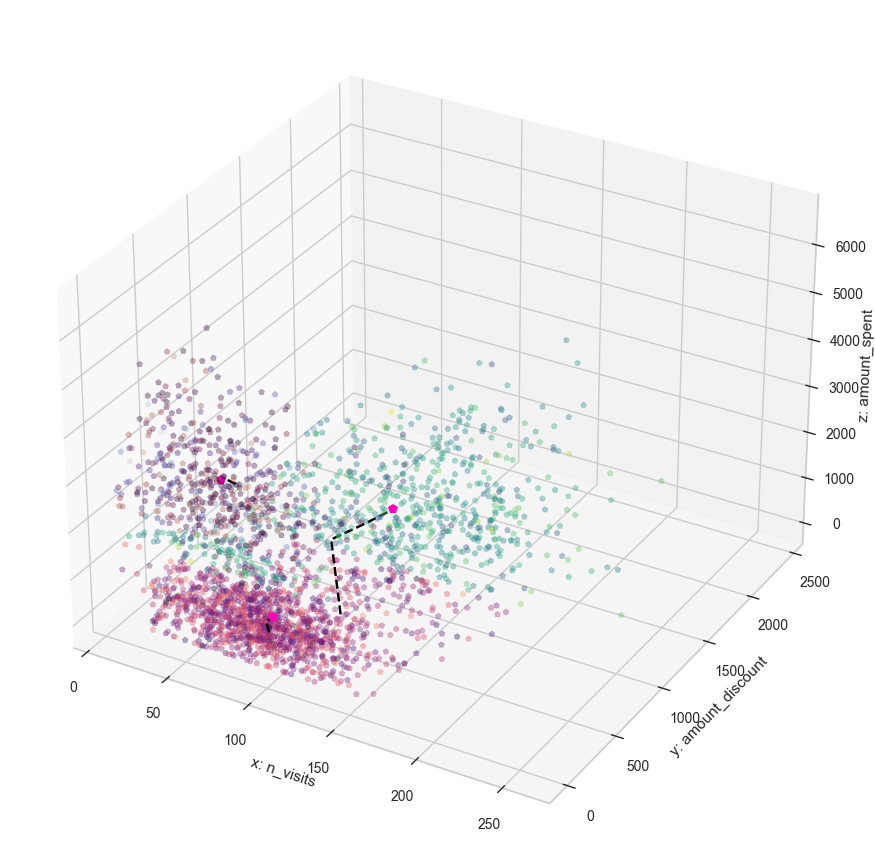

In [37]:
data = load_ecomm_data('./data/E-commerce.csv', ['n_visits', 'amount_discount', 'amount_spent'])

# model = KMeans(data, 3,)
model = KMeans_2(data, 3, epochs=300, dist_metric='minkowski', features=['n_visits', 'amount_discount', 'amount_spent'], p=2)
model.train()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[[ 300.          132.          228.43250321]
 [ 743.83250752   86.           60.88283134]
 [ 305.66888582  334.           72.96180132]
 ...
 [ 936.91595926   96.          146.63741213]
 [ 404.90529604  194.          119.28416225]
 [1433.67721871  271.         1138.21948445]]
initial centroids [[2446.72775239  229.           37.85938671]
 [1331.4548653   268.         1033.49677494]
 [ 466.44437635  170.           54.09581073]]



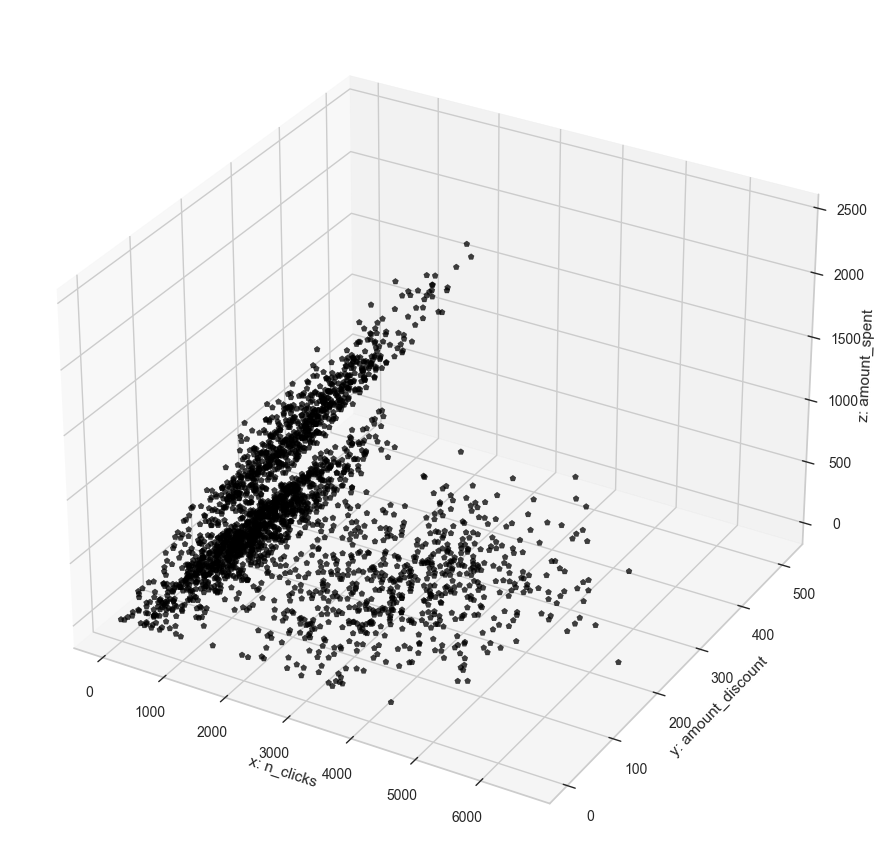

centroid at epoch 0/299: 
[[2446.72775239  229.           37.85938671]
 [1331.4548653   268.         1033.49677494]
 [ 466.44437635  170.           54.09581073]]

points of cluster 0: [[3550.73229352  200.           43.9636836 ]
 [4006.94232947  147.          145.46900631]
 [2335.62131143   36.           57.45648623]
 ...
 [3341.99832216  285.           81.04646503]
 [3328.6281992   157.          148.31370195]
 [1985.95420556  220.            5.12945728]]

points of cluster 1: [[1008.16977135  165.          717.69649646]
 [ 844.54096823  171.          723.35029124]
 [1069.99896794  258.          790.61843479]
 ...
 [2217.9562001    73.         1855.35659043]
 [ 914.89154263  135.          693.29050793]
 [1433.67721871  271.         1138.21948445]]

points of cluster 2: [[300.         132.         228.43250321]
 [743.83250752  86.          60.88283134]
 [305.66888582 334.          72.96180132]
 ...
 [638.1128076  114.         206.5650959 ]
 [936.91595926  96.         146.63741213]
 [404

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


m: (301, 3)
centroids of cluster 0: [[2446.72775239  229.           37.85938671]
 [3165.40826955  198.35690789   77.82331031]
 [3323.70853563  196.38025594   81.13933996]
 [3390.40002873  198.74615385   82.89059452]
 [3417.50004109  197.82711198   83.69887109]
 [3434.47393573  197.47410359   84.10693503]
 [3446.59269415  197.63983903   84.29511424]
 [3453.85006909  198.06882591   84.41651234]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  198.13184584   84.37111811]
 [3456.22412563  19

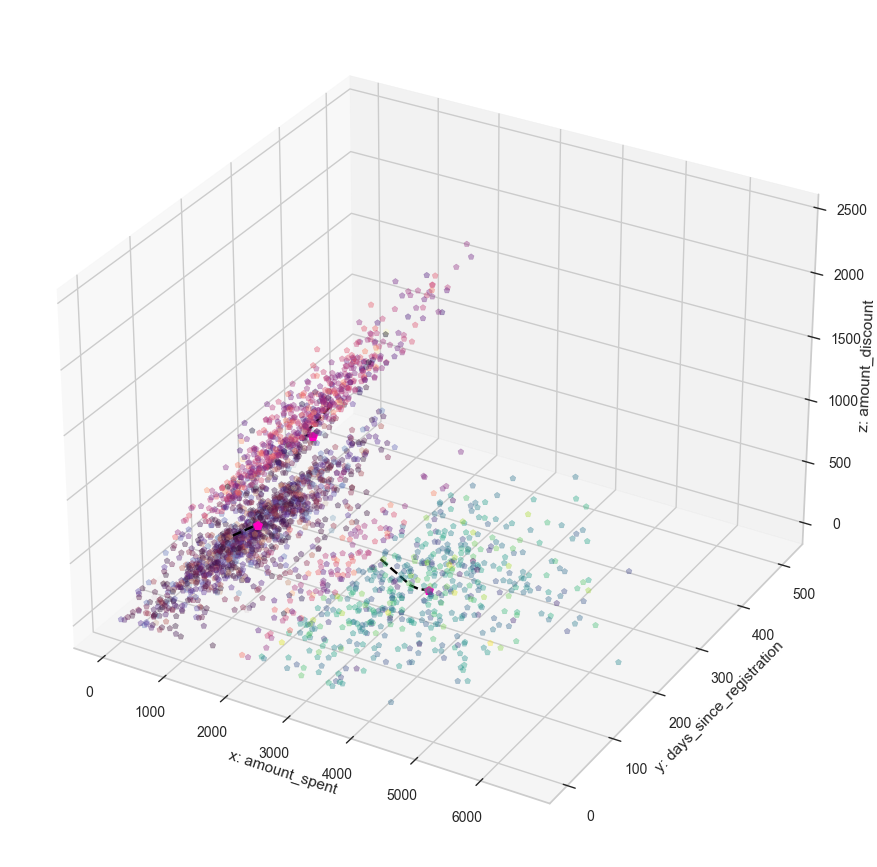

In [38]:
data = load_ecomm_data('./data/E-commerce.csv', ['amount_spent', 'days_since_registration', 'amount_discount'])

# model = KMeans(data, 3,)
model = KMeans_2(data, 3, epochs=300, dist_metric='minkowski', features=['amount_spent', 'days_since_registration', 'amount_discount'], p=2)
model.train()

X: amount spent by user, Y: days since registration by user, Z: amount discount granted to user
magma cluster users:
X: 2000-5000, Y: 0-450, Z: 0-250

viridis cluster users:
X: 0-1000, Y: 0-450, Z: 0-750

twilight cluster users:
X: 1000-2500, Y: 0-450, Z: 750-2125

Conclusions: Firstly in the magma cluster these users have a relatively high amount spent (between 2000 and 5000). They are relatively new to the platform (within 0-450 days since registration) and receive moderate discounts (0-250). These users may be early adopters or high-value customers who are willing to spend more. In the viridis cluster these users have a lower amount spent (between 0 and 1000), similar registration duration (0-450 days), but can receive higher discounts (0-750). They might be price-sensitive customers who are attracted to larger discounts and lower-priced products. Lastly the in the twilight cluster these users have moderate amounts spent (between 1000 and 2500), similar registration duration (0-450 days), and relatively higher discounts (750-2125). They might be customers who respond well to specific discount offers and are willing to make moderate purchases.



X: number of clicks by user in platform, Y: amount discount granted to user, Z: amount spent by user
magma cluster users:
X: 125-800, Y: 0-750, Z: 0-1500

viridis cluster users:
X: 200-900, Y: 0-2000, Z: 1500-2000

twilight cluster users:
X: 0-600, Y: 0-250, Z: 2400-6000

Conclusions: Firstly in the magma cluster these users have a moderate number of clicks (125-800), moderate discounts received (0-750), and moderate amounts spent (0-1500). They are engaged with the platform, take advantage of discounts, and make reasonable purchases. In the viridis cluster these users have a higher number of clicks (200-900), wider range of discounts (0-2000), and higher amounts spent (1500-2000). They might be highly engaged customers who explore the platform extensively, are attracted by discounts, and make significant purchases. In the twilight cluster these users have a lower number of clicks (0-600), receive moderate discounts (0-250), but have higher amounts spent (2400-6000). They might be less active in browsing or exploring but are more focused on specific products or categories, leading to higher spending.



X: number of visits by user on platform, Y: amount discount granted to user, Z: amount spent by user
magma cluster users:
X: 0-125 , Y: 0-250, Z: 2500-2600

viridis cluster users:
X: 45-200, Y: 0-2000, Z: 1000-2500

twilight cluster users:
X: 45-200 , Y: 0-750, Z: 0-1500

Conclusions: Firstly in the magma cluster these users have a relatively low number of visits (0-125), receive moderate discounts (0-250), and have a narrow range of amounts spent (2500-2600). They might be infrequent visitors who have specific preferences or requirements, resulting in fewer visits but higher spending. In the viridis cluster these users have a moderate number of visits (45-200), wider range of discounts (0-2000), and a moderate range of amounts spent (1000-2500). They engage with the platform regularly, are attracted to discounts, and make moderate purchases. In the twilight cluster these users have a moderate number of visits (45-200), receive moderate discounts (0-750), and have a moderate range of amounts spent (0-1500). They exhibit similar behavior to the Viridis Cluster users but with lower spending tendencies.

